In [1]:
import multiprocessing
import os
import sys
import time
import numpy as np
import pandas as pd
import matplotlib.cm as cm
import re
import spacy
from gensim.models import Word2Vec
from nltk.corpus import cess_esp
from nltk.corpus import brown
from tqdm import tqdm
import operator
from text_analysis import TextAnalysis
from utils import Utils
from root import DIR_IMAGE, DIR_MODELS, DIR_EMBEDDING, DIR_INPUT
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
nlp = spacy.load("es_core_news_sm")

/home/gritas01/.local/lib/python3.8/site-packages/torch/cuda/__init__.py:546: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


In [2]:
class Embedding(object):

    def __init__(self, lang='es'):
        self.lang = lang
        self.cores = multiprocessing.cpu_count()
        #self.part_corpus = self.import_part_corpus(lang)
        self.text_analysis = TextAnalysis(lang)
        self.corpus = self.import_words_corpus()

    def import_words_corpus(self):
   
        result = []
        
        try:
            #file_tweet = '/home/gritas01/PhonesthemsV2/data/input/Valence_train_oc_es.csv'
            #print('Loading.... corpus from directory: {0}'.format(file_tweet))
            #corpus = self.text_analysis.import_corpus(file=file_tweet)
            #result = [i[1] for i in corpus]
            
            
        
            file_corpus_charta = '/home/gritas01/PhonesthemsV2/data/input/charta'
            print('Loading.... corpus from directory: {0}'.format(file_corpus_charta))
            
            
            for fichier in tqdm(os.listdir(file_corpus_charta)):
 
                chemin_fichier = os.path.join(file_corpus_charta, fichier)
                with open(chemin_fichier, 'r', encoding='latin-1') as file:
                    # Lire le contenu du fichier .txt
                    contenu = file.read()

                    result.append(contenu)
            
            
                
            print('Loading.... {0} corpus'.format('CESS'))
            sentences_list = cess_esp.sents()
            for sent in tqdm(list(sentences_list)):
                list_text = [str(token).lower() for token in list(sent)]
                text = ' '.join(list_text)
                result.append(text)
            
            
            result_clean=[]
            print('Cleaning of text...')
            for text in tqdm(result):
                result_clean.append(TextAnalysis.clean_text(text))
            
            print('Loading... {0} corpus'.format('Tweet'))
            #file_tweet=pd.read_csv('/home/gritas01/PhonesthemsV2/data/input/SemEval-2018_AIT_DISC_ES.csv', sep=';')
            file_tweet=pd.read_csv('/home/gritas01/PhonesthemsV2/data/input/Valence_train_oc_es.csv', sep=';')
            for row in tqdm(file_tweet['Tweet']):
                row_clean=TextAnalysis.clean_text(row)
                if len(re.findall(r'\w+', row_clean))>2:    #Verification que le texte est utile
                    result_clean.append(row_clean)
            
        except Exception as e:
            Utils.standard_error(sys.exc_info())
            print('Error import_words_corpus: {0}'.format(e))
        return result_clean

    
    
    def import_part_corpus(self, lang='es'):
       
        result = []
        try:
            print('Loading.... {0} corpus'.format('CESS'))
            sentences_list = cess_esp.sents()
            for sent in tqdm(list(sentences_list)):
                list_text = [str(token).lower() for token in list(sent)]
                text = ' '.join(list_text)
                result.append(text)
        except Exception as e:
            Utils.standard_error(sys.exc_info())
            print('Error import_phonemes_corpus: {0}'.format(e))
        return result

    
    
    def words_embedding(self, model_name='word_embedding', size=300, min_count=50, window=5, sample=6e-5, negative=20,
                        alpha=0.03, min_alpha=0.0007):
        try:
            start_time = time.time()
            corpus_vec = self.text_analysis.sentences_vector(self.corpus)

            model = Word2Vec(corpus_vec, cbow_mean=1, workers=self.cores-1, vector_size=size, min_count=min_count,
                             window=window, sample=sample, negative=negative, alpha=alpha, min_alpha=min_alpha, epochs=10)

            model_name = model_name + '_' + self.lang
            file_name = DIR_MODELS + model_name + '.model'
            model.save(file_name)
            print('Model {0} generated successful!'.format(model_name))

            #vocabulary = list(model.wv.vocab)
            vocabulary=list(model.wv.index_to_key)
            print('Vocabulary: {0}'.format(vocabulary))

            self.text_analysis.token_frequency(model_name=model_name, corpus_vec=corpus_vec)
            # Calculated Time processing
            t_sec = round(time.time() - start_time)
            (t_min, t_sec) = divmod(t_sec, 60)
            (t_hour, t_min) = divmod(t_min, 60)
            time_processing = '{} hour:{} min:{} sec'.format(t_hour, t_min, t_sec)
            print('Time Processing: {}'.format(time_processing))
        except Exception as e:
            Utils.standard_error(sys.exc_info())
            print('Error words_embedding: {0}'.format(e))

    def part_embedding(self, model_name='part_embedding', size=150, min_count=10, window=5, sample=6e-5, negative=20,
                       alpha=0.03, min_alpha=0.0007, syllable=False):
    
        try:
            start_time = time.time()
            corpus_vec = self.text_analysis.part_vector(self.corpus, syllable=syllable)

            model = Word2Vec(corpus_vec, cbow_mean=1, workers=self.cores-1, vector_size=size, min_count=min_count,
                             window=window, sample=sample, negative=negative, alpha=alpha, min_alpha=min_alpha, epochs=10)

            model_name = model_name + '_' + self.lang
            file_name = DIR_MODELS + model_name + '.model'
            model.save(file_name)
            print('Model {0} generated successful!'.format(file_name))

            #vocabulary = list(model.wv.vocab)
            vocabulary = list(model.wv.index_to_key)

            print('Vocabulary: {0}'.format(vocabulary))

            self.text_analysis.token_frequency(model_name=model_name, corpus_vec=corpus_vec)
            #Calculated Time processing
            t_sec = round(time.time() - start_time)
            (t_min, t_sec) = divmod(t_sec, 60)
            (t_hour, t_min) = divmod(t_min, 60)
            time_processing = '{} hour:{} min:{} sec'.format(t_hour, t_min, t_sec)
            print('Time Processing: {}'.format(time_processing))
        except Exception as e:
            Utils.standard_error(sys.exc_info())
            print('Error part_embedding: {0}'.format(e))

            
        
    def get_similarity(self, model_name):
        dict_vocabulary = {}
        try:
            file_model = "{0}{1}_{2}.model".format(DIR_MODELS, model_name, self.lang)
            model = Word2Vec.load(file_model, mmap=None)
            #vocabulary = list(model.wv.vocab)
            vocabulary=list(model.wv.index_to_key)
            for i in vocabulary:
                dict_vocabulary[i] = model.wv.most_similar(i)
                if i != '':
                    print('Token: {0}\nMost Similar:'.format(i))
                    for j in model.wv.most_similar(i):
                        print(j)
            print(vocabulary)
        except Exception as e:
            Utils.standard_error(sys.exc_info())
            print('Error get_similarity: {0}'.format(e))
        return dict_vocabulary

    
    
    
    @staticmethod
    def plot(model_name, file_name, size=15, label=False):
        try:
            print('Plot {0} embedding...'.format(model_name))
            sep = os.sep
            #Creates and TSNE model and plots it
            file_model = DIR_MODELS + model_name + ".model"
           
            model = Word2Vec.load(file_model)
            embedding_vectors = model.wv.vectors  
            
            # t-SNE pour réduire la dimension à 2
            tsne = TSNE(n_components=2, random_state=42)
            embedded_data = tsne.fit_transform(embedding_vectors)
            
            plt.figure(figsize=(10, 8))
            plt.scatter(embedded_data[:, 0], embedded_data[:, 1], marker='o', s=40)
            plt.title("t-SNE Embedding of Model " + model_name)
            
            if label:
                for i, word in enumerate(model.wv.index_to_key):
                    plt.annotate(word, (embedded_data[i, 0], embedded_data[i, 1]), fontsize=8, alpha=0.7)
                
            plt.savefig('/home/gritas01/PhonesthemsV2/data/output'+sep+file_name, format="png", dpi=150)
            plt.show()
        except Exception as e:
            Utils.standard_error(sys.exc_info())
            print('Error plot: {0}'.format(e))

    def plot_classification(model_name, size=15, label=False):
        try:
            print('Plot {0} embedding...'.format(model_name))
            sep = os.sep
            #Creates and TSNE model and plots it
            file_model = DIR_MODELS + model_name + ".model"
           
            model = Word2Vec.load(file_model)
            embedding_vectors = model.wv.vectors  
            
            # t-SNE pour réduire la dimension à 2
            tsne = TSNE(n_components=2, random_state=42)
            embedded_data = tsne.fit_transform(embedding_vectors)
            
            plt.figure(figsize=(10, 8))
            category_colors = {'VERB': 'red', 'NOUN': 'blue', 'ADJ': 'green', 'ADV': 'purple','DET': 'orange' ,'PRON': 'brown', 'CONJ' : 'pink', 'OTHER': 'gray'}
            legend_labels = ['VERB','NOUN','ADJ','ADV', 'DET', 'PRON', 'CONJ','OTHER']
            legend_colors = ['red','blue','green','purple', 'orange', 'brown', 'pink','gray']
            
            vocab=list(model.wv.index_to_key)
            for i,word in enumerate(vocab):
                category = get_category_word(word)
                plt.scatter(embedded_data[i, 0], embedded_data[i, 1], marker='o', s=40, c=category_colors.get(category, 'black'))
            
            plt.legend(legend_labels, loc='upper right')
            plt.title("t-SNE Embedding of Model Vectors " + model_name)
            
            if label:
                for i, word in enumerate(model.wv.index_to_key):
                    plt.annotate(word, (embedded_data[i, 0], embedded_data[i, 1]), fontsize=8, alpha=0.7)
                
            plt.savefig('/home/gritas01/PhonesthemsV2/data/output/word_embedding_classificate.png', format="png", dpi=150)
            plt.show()
       
        except Exception as e:
            Utils.standard_error(sys.exc_info())
            print('Error plot: {0}'.format(e))

            
        def get_category_word(word):
            
            doc = nlp(word)
            
            for token in doc :
                if token.pos_ == 'VERB' or 'AUX':
                    return "VERB"
                elif token.pos_ == 'NOUN':
                    return 'NOUN'
                elif token.pos_ == 'ADJ':
                    return 'ADJ'
                elif token.pos_ == 'ADV':
                    return 'ADV'
                elif token.pos_ == 'DET':
                    return 'DET'
                elif token.pos_ == 'PRON':
                    return 'PRON'
                elif token.pos_ == 'SCONJ' or token.pos_ == 'CCONJ':
                    return 'CONJ'
            
            return "OTHER"

In [3]:
#WORD EMBEDDING

em = Embedding(lang='es')
em.words_embedding(model_name='word_embedding', size=300)
em.get_similarity(model_name='word_embedding')

/home/gritas01/.local/lib/python3.8/site-packages/spacy/util.py:910: UserWarning: [W095] Model 'es_core_news_lg' (3.5.0) was trained with spaCy v3.5 and may not be 100% compatible with the current version (3.6.0). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)
  3%|▎         | 25/801 [00:00<00:03, 243.04it/s]

Language: es
Text Analysis: ['tok2vec', 'morphologizer', 'emoji', 'syllables', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']
Loading.... corpus from directory: /home/gritas01/PhonesthemsV2/data/input/charta


100%|██████████| 801/801 [00:01<00:00, 690.67it/s]


Loading.... CESS corpus


  0%|          | 17/6831 [00:00<00:40, 169.14it/s]

Cleaning of text...


  0%|          | 0/1566 [00:00<?, ?it/s]

Loading... Tweet corpus


100%|██████████| 8391/8391 [07:03<00:00, 19.83it/s] 


Model word_embedding_es generated successful!
Vocabulary: ['de', 'e', 'que', 'la', 'en', 'el', 'los', 'a', 'por', 'don', 'del', 'confirma', 'y', 'las', 'con', 'rey', 'lo', 'non', 'se', 'obispo', 'su', 'al', 'esta', 'un', 'o', 'como', 'd', 'yo', 'no', 'es', 'nin', 'sus', 'carta', 'alfonso', 'una', 'les', 'bien', 'para', 'si', 'me', 'pora', 'todos', 'más', 'mi', 'sea', 'león', 'este', 'sevilla', 'pero', 'castiella', 'nós', 'todo', 'toledo', 'porque', 'ellos', 'joán', 'pérez', 'dios', 'era', 'murcia', 'años', 'mio', 'fazer', 'nuestro', 'esto', 'contra', 'mill', 'vos', 'otros', 'gracia', 'córdova', 'concejo', 'días', 'ý', 'mando', 'jaén', 'vós', 'otrossí', 'gallizia', 'assí', 'omnes', 'mayor', 'son', 'nos', 'mandado', 'razón', 'dar', 'eglesia', 'cosa', 'año', 'fpa', 'fpt', 'mencion', 'infante', 'ha', 'dos', 'él', 'sobre', 'ninguno', 'moravedís', 'otro', 'sobredicho', 'ninguna', 'le', 'ello', 'sancho', 'cosas', 'mí', 'ni', 'cuando', 'aquí', 'ferrando', 'cómo', 'fijo', 'tiempo', 'garcía', 'c

{'de': [('la', 0.7072811722755432),
  ('del', 0.6675329208374023),
  ('sevilla', 0.6290875673294067),
  ('murcia', 0.5859004855155945),
  ('córdova', 0.5645812153816223),
  ('león', 0.5631590485572815),
  ('toledo', 0.5562953948974609),
  ('en', 0.5505710244178772),
  ('algarve', 0.5230185389518738),
  ('gallizia', 0.5212185978889465)],
 'e': [('valladolit', 0.6921778321266174),
  ('diemos', 0.6652125716209412),
  ('bitoria', 0.6553702354431152),
  ('nós', 0.6170591115951538),
  ('sobredicho', 0.610917329788208),
  ('fazer', 0.6100136637687683),
  ('concejo', 0.595299243927002),
  ('fuessen', 0.5933800339698792),
  ('cibdat', 0.5892592072486877),
  ('seellos', 0.583204448223114)],
 'que': [('seer', 0.7144559621810913),
  ('mas', 0.7036488056182861),
  ('cuando', 0.6875824928283691),
  ('aquella', 0.683320939540863),
  ('aquello', 0.6629654169082642),
  ('quieren', 0.6623615026473999),
  ('recabdar', 0.6597225666046143),
  ('salvo', 0.6579781770706177),
  ('derecho', 0.6519767642021179)

Plot word_embedding_es embedding...


/home/gritas01/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/gritas01/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


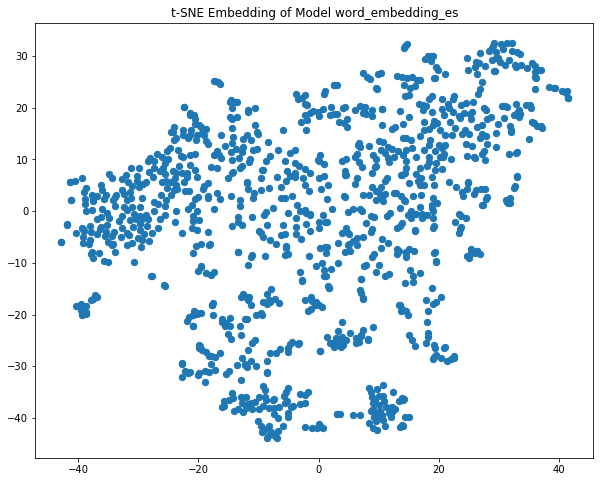

Plot word_embedding_es embedding...


/home/gritas01/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/gritas01/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


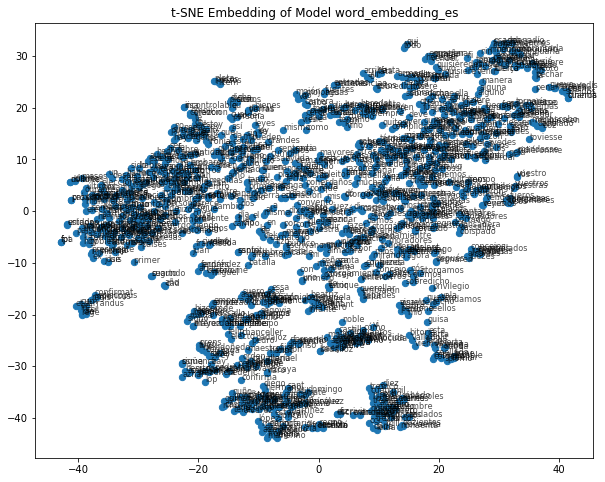

Plot <__main__.Embedding object at 0x7f0a1272cdf0> embedding...
Error plot: can only concatenate str (not "Embedding") to str


In [4]:
em.plot('word_embedding_es', file_name='word_embedding.png', label=False)
em.plot('word_embedding_es', file_name='word_embedding_label.png', label=True)
em.plot_classification('word_embedding_es', label=False)

/home/gritas01/.local/lib/python3.8/site-packages/spacy/util.py:910: UserWarning: [W095] Model 'es_core_news_lg' (3.5.0) was trained with spaCy v3.5 and may not be 100% compatible with the current version (3.6.0). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)
100%|██████████| 801/801 [00:00<00:00, 26796.07it/s]

Language: es
Text Analysis: ['tok2vec', 'morphologizer', 'emoji', 'syllables', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']
Loading.... corpus from directory: /home/gritas01/PhonesthemsV2/data/input/charta
Loading.... CESS corpus



  0%|          | 16/6831 [00:00<00:43, 157.71it/s]

Cleaning of text...


 27%|██▋       | 417/1566 [00:00<00:00, 4166.06it/s]

Loading... Tweet corpus


100%|██████████| 1566/1566 [00:00<00:00, 4095.46it/s]


Sentence: sepan cuantos esta carta vieren cómo yo don ferrando por la gracia de dios rey de castiella de toledo de león de gallizia de sevilla de córdova de murcia de jaén del algarbe e señor de molina vi una carta que ovo mandado dar el rey don sancho mio padre que dios perdone al obispo de burgos e a la su eglesia fecha en esta guisa don sancho por la gracia de dios rey de castiella de toledo de león de gallizia de sevilla de córdova de murcia de jaén e del algarbe a todos los merinos de las merindades del obispado de burgos e a los cogedores de la fonsadera en essas merindades salut e gracia sepades que el obispo de burgos me dixo que cuando acaece que yo mando coger la fonsadera por la tierra que vós que demandades fonsadera a los vassallos que él e su eglesia an en essas merindades e los peindrades por ella e sobr esto mostrome los privilegios que tienen de los reis onde yo vengo confirmados del rey don alfonso mio padre que dios perdone e de mí e fallé que los vassallos del obisp

/home/gritas01/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/gritas01/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


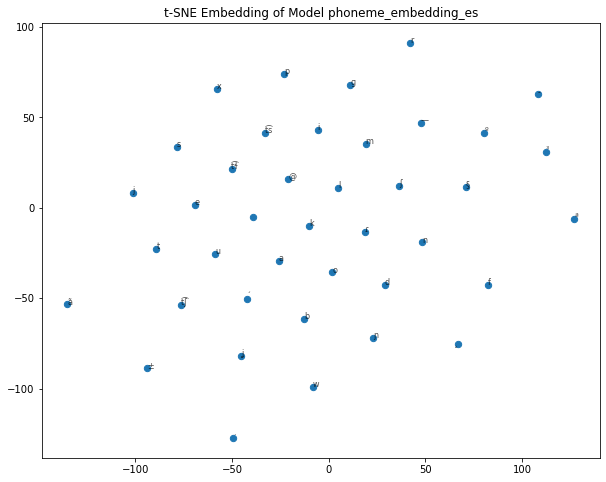

In [9]:
#PHONEME EMBEDDING

em = Embedding(lang='es')
em.part_embedding(model_name='phoneme_embedding')
em.get_similarity(model_name='phoneme_embedding')
em.plot('phoneme_embedding_es', file_name='phoneme_embedding.png', label = True)

In [ ]:
#PHONESTHEM EMBEDDING

em = Embedding(lang='es')
em.part_embedding(model_name='phonesthem_embedding', syllable=True)
em.get_similarity(model_name='phonesthem_embedding')

/home/gritas01/.local/lib/python3.8/site-packages/spacy/util.py:910: UserWarning: [W095] Model 'es_core_news_lg' (3.5.0) was trained with spaCy v3.5 and may not be 100% compatible with the current version (3.6.0). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)
100%|██████████| 801/801 [00:00<00:00, 18349.95it/s]

Language: es
Text Analysis: ['tok2vec', 'morphologizer', 'emoji', 'syllables', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']
Loading.... corpus from directory: /home/gritas01/PhonesthemsV2/data/input/charta
Loading.... CESS corpus



  0%|          | 18/6831 [00:00<00:38, 175.20it/s]

Cleaning of text...


 26%|██▋       | 414/1566 [00:00<00:00, 4139.88it/s]

Loading... Tweet corpus


100%|██████████| 1566/1566 [00:00<00:00, 4152.66it/s]


Sentence: sepan cuantos esta carta vieren cómo yo don ferrando por la gracia de dios rey de castiella de toledo de león de gallizia de sevilla de córdova de murcia de jaén del algarbe e señor de molina vi una carta que ovo mandado dar el rey don sancho mio padre que dios perdone al obispo de burgos e a la su eglesia fecha en esta guisa don sancho por la gracia de dios rey de castiella de toledo de león de gallizia de sevilla de córdova de murcia de jaén e del algarbe a todos los merinos de las merindades del obispado de burgos e a los cogedores de la fonsadera en essas merindades salut e gracia sepades que el obispo de burgos me dixo que cuando acaece que yo mando coger la fonsadera por la tierra que vós que demandades fonsadera a los vassallos que él e su eglesia an en essas merindades e los peindrades por ella e sobr esto mostrome los privilegios que tienen de los reis onde yo vengo confirmados del rey don alfonso mio padre que dios perdone e de mí e fallé que los vassallos del obisp

In [ ]:
em.plot('phonesthem_embedding_es', file_name='phonestem_embedding')
em.plot('phonesthem_embedding_es', file_name='phonestem_embedding_label', label=True)

In [ ]:
print('Success notebook')